In [12]:
%matplotlib inline
import random
import matplotlib

from parcels import FieldSet, ParticleSet, JITParticle, AdvectionRK4
import parcels
from datetime import timedelta, datetime
import numpy as np

import matplotlib.pyplot as plt

In [4]:
INIT_SEED = 123
MAP_W = 350
MAP_H = 170

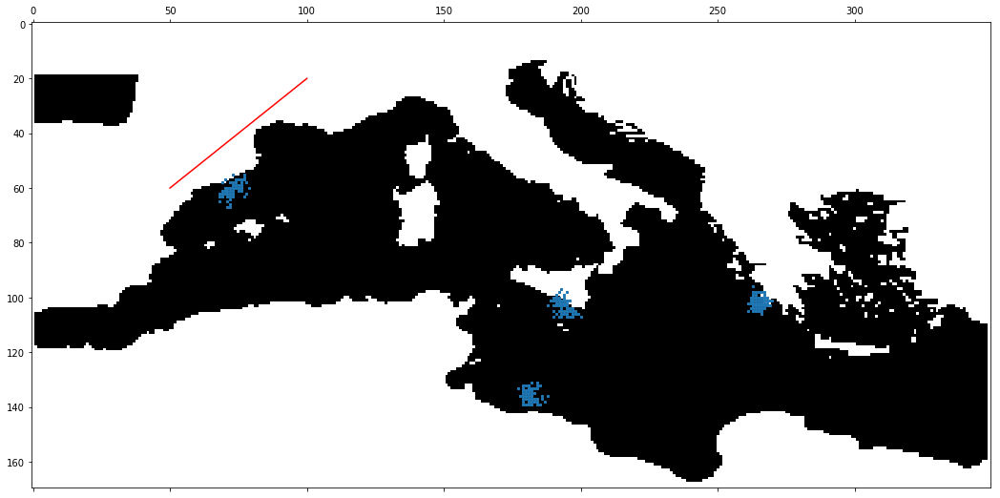

In [52]:
from matplotlib import animation, rc
from IPython.display import HTML, display
import pickle

from scipy.sparse import csr_matrix

with open('../output/coord_dict_large.p', 'rb') as f:
    data = pickle.load(f)
    
mask = np.load('../output/europe_mask.npy')
mask = np.roll(mask, -9, axis=0)
fig, ax = plt.subplots(1, 1, figsize=(18, 12))

ax.imshow(mask[::-1,:], cmap='gray')
def init(fig, ax):
    mat = np.zeros((MAP_H, MAP_W))
    for k, v in data[0].items():
        mat[MAP_H-int(v[1]/10), int(v[0]/10)] += 1
    ax.spy(mat, markersize=2)

net_tests = 185*[[[100,20],[50,60]],[[50,30],[10,60]]]

def simulate(i):
    mat = np.zeros((MAP_H, MAP_W))
    net_test=net_tests[i]
    l = matplotlib.lines.Line2D([net_test[0][0],net_test[0][1]], [net_test[1][1],net_test[1][1]], c='red')
    plt.cla()
    
    ax.imshow(mask[::-1,:], cmap='gray')
    
    for k, v in data[i].items():
        mat[MAP_H-int(v[1]/10), int(v[0]/10)] += 1
    ax.spy(mat, markersize=2)
    ax.add_line(l)
    return (ax,)

anim = animation.FuncAnimation(fig, simulate, init_func=init(fig, ax),
                               frames=359, interval=200, 
                               blit=False)


HTML(anim.to_jshtml())

In [90]:
%matplotlib inline
import random
import matplotlib

from matplotlib import animation, rc
from IPython.display import HTML, display
import pickle

from datetime import timedelta, datetime
import numpy as np

import matplotlib.pyplot as plt


MAP_W = 350
MAP_H = 170

def plot_evolution(net_pos_file, data_points_file):
    with open(data_points_file, 'rb') as f:
        data = pickle.load(f)
    
    mask = np.load('../output/europe_mask.npy')
    mask = np.roll(mask, -9, axis=0)
    fig, ax = plt.subplots(1, 1, figsize=(18, 12))
    
    # Load results
    with open(net_pos_file, 'rb') as f:
        net_results = pickle.load(f)

    ax.imshow(mask[::-1,:], cmap='gray')
    def init(fig, ax):
        mat = np.zeros((MAP_H, MAP_W))
        for k, v in data[0].items():
            mat[MAP_H-int(v[1]/10), int(v[0]/10)] += 1
        ax.spy(mat, markersize=2)

    def simulate(i):
        mat = np.zeros((MAP_H, MAP_W))
        net_test=net_results[i]
        l = matplotlib.lines.Line2D([net_test[0][0],net_test[1][0]], [MAP_H-net_test[0][1],MAP_H-net_test[1][1]], c='red')
        plt.cla()

        ax.imshow(mask[::-1,:], cmap='gray')

        for k, v in data[i].items():
            mat[MAP_H-int(v[1]/10), int(v[0]/10)] += 1
        ax.spy(mat, markersize=2)
        ax.add_line(l)
        return (ax,)

    anim = animation.FuncAnimation(fig, simulate, init_func=init(fig, ax),
                                   frames=359, interval=200, 
                                   blit=False)
    
    display(HTML(anim.to_jshtml()))


In [22]:
# Multithreading
import multiprocessing as mp

result_list = []
def log_result(result):
    # This is called whenever foo_pool(i) returns a result.
    # result_list is modified only by the main process, not the pool workers.
    result_list.append(result)

def apply_async_with_callback():
    pool = mp.Pool()
    for i in range(10):
        pool.apply_async(plot_evolution, args = (results[i], ))#, callback = log_result)
    pool.close()
    pool.join()
    print(result_list)

if __name__ == '__main__':
    apply_async_with_callback()


[20, 60]

In [85]:
# Watcher for new saved files
import os
from os import listdir
from os.path import isfile, join
import time
from datetime import datetime

def get_episode_number(fname):
    return int(os.path.splitext(fname)[0].split('episode_')[1])

def load_and_plot_episode(m):
    data_points_file = f'../ML/results/particles_pos_episode_{m}.pkl'
    results_file = f'../ML/results/fishnet_pos_episode_{m}.pkl'
    plot_evolution(results_file, data_points_file)

def watch_folder(folder):
    largest_episode = -1
    while(1):
        onlyfiles = [f for f in listdir(folder) if isfile(join(folder, f))]
        ns = [get_episode_number(n) for n in onlyfiles]
        m = max(ns)
        if m > largest_episode:
            print(f"NEW EPISODE! (episode: {m})")
            largest_episode = m
            load_and_plot_episode(m)
        else:
            print(f"{datetime.now()} : No new episode found")
            time.sleep(30)


NEW EPISODE!


NEW EPISODE!


EOFError: Ran out of input

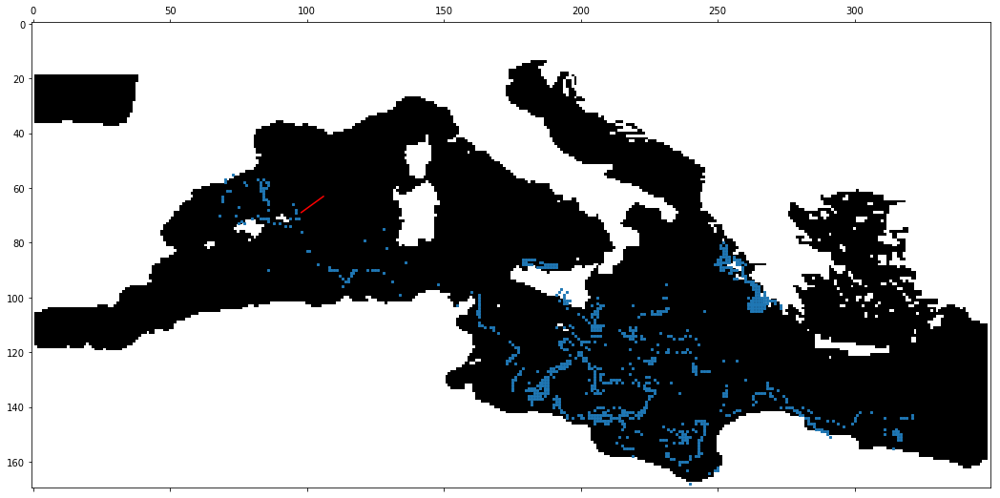

In [91]:
watch_folder('../ML/results/')

In [80]:
with open(f'../ML/results/fishnet_pos_episode_{0}.pkl', 'rb') as f:
    ff = pickle.load(f)

In [81]:
ff

[(array([147.75528258, 134.54508497]), array([138.24471742, 131.45491503])),
 (array([147.75528258, 133.54508497]), array([138.24471742, 130.45491503])),
 (array([147.75528258, 132.54508497]), array([138.24471742, 129.45491503])),
 (array([146.75528258, 132.54508497]), array([137.24471742, 129.45491503])),
 (array([147.75528258, 132.54508497]), array([138.24471742, 129.45491503])),
 (array([147.75528258, 133.54508497]), array([138.24471742, 130.45491503])),
 (array([147.04508497, 134.93892626]), array([138.95491503, 129.06107374])),
 (array([146.04508497, 134.93892626]), array([137.95491503, 129.06107374])),
 (array([146.04508497, 134.93892626]), array([137.95491503, 129.06107374])),
 (array([146.04508497, 134.93892626]), array([137.95491503, 129.06107374])),
 (array([147.04508497, 134.93892626]), array([138.95491503, 129.06107374])),
 (array([147.04508497, 135.93892626]), array([138.95491503, 130.06107374])),
 (array([147.04508497, 134.93892626]), array([138.95491503, 129.06107374])),

In [33]:
data=get_line(net_test[0][0],net_test[1][0], net_test[0][1],net_test[1][1])
data=np.array(data)
csr_matrix((len(data)*[1], (data[:,0], data[:,1])))

<101x61 sparse matrix of type '<class 'numpy.int64'>'
	with 81 stored elements in Compressed Sparse Row format>

In [31]:
np.array(data)[:,0]

array([100,  99,  98,  97,  96,  95,  94,  93,  92,  91,  90,  89,  88,
        87,  86,  85,  84,  83,  82,  81,  80,  79,  78,  77,  76,  75,
        74,  73,  72,  71,  70,  69,  68,  67,  66,  65,  64,  63,  62,
        61,  60,  59,  58,  57,  56,  55,  54,  53,  52,  51,  50,  49,
        48,  47,  46,  45,  44,  43,  42,  41,  40,  39,  38,  37,  36,
        35,  34,  33,  32,  31,  30,  29,  28,  27,  26,  25,  24,  23,
        22,  21,  20])